## <center> Dimensionality Reduction (Principal Component Analysis (PCA) and t-Distributed Stochastic Neighbor Embedding (t-SNE) for Ground Coffee </center>

In [2]:
# Load packages 
import os 
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE


In [3]:
# set the working directory 
os.chdir('C:/Users/abc/OneDrive - UGent/Documenten/Derick Malavi_PhD Docs_UGent/Manuscript 4_Coffee')

In [4]:
# Read_data. Import the files for ground coffee
ground_raw = pd.read_csv('coffee_data_pycleaned.csv')
ground_msc_sg_1d = pd.read_csv('coffee_ground_msc_sg_1d.csv')
ground_msc_sg_2d = pd.read_csv('coffee_ground_msc_sg_2d.csv')
ground_snv_sg_1d = pd.read_csv('coffee_ground_snv_sg_1d.csv')
ground_snv_sg_2d = pd.read_csv('coffee_ground_snv_sg_2d.csv')

In [5]:
ground_raw.head()

,sample_id,binary_class,three_class,adult_percent,cal_val,935.609985,939.059998,942.52002,945.97998,949.429993,...,1688.02002,1691.589966,1695.170044,1698.75,1702.329956,1705.910034,1709.48999,1713.069946,1716.650024,1720.22998
0,Pure_Arabica_10,pure_arabica,pure_arabica,0,1,0.347876,0.349376,0.363904,0.375547,0.384829,...,0.520932,0.512153,0.502902,0.492153,0.481531,0.470791,0.460815,0.450851,0.441252,0.430884
1,Pure_Arabica_3,pure_arabica,pure_arabica,0,1,0.332850,0.334093,0.346032,0.356395,0.364701,...,0.529074,0.519696,0.509692,0.497895,0.486415,0.474300,0.463489,0.452816,0.442621,0.432088
2,Pure_Arabica_2,pure_arabica,pure_arabica,0,1,0.347639,0.349199,0.363783,0.375387,0.384600,...,0.536934,0.527794,0.518312,0.507230,0.496132,0.484015,0.474116,0.463680,0.453512,0.442852
3,Pure_Arabica_2,pure_arabica,pure_arabica,0,1,0.338413,0.339599,0.350815,0.362448,0.370806,...,0.519080,0.510286,0.500799,0.489834,0.479003,0.467816,0.457893,0.447762,0.437734,0.427460
4,Pure_Arabica_2,pure_arabica,pure_arabica,0,1,0.343888,0.345065,0.357601,0.368907,0.377726,...,0.528300,0.519557,0.510316,0.499657,0.489016,0.477639,0.467895,0.458040,0.447648,0.436710


In [6]:
# Select the X columns
X_raw = ground_raw.iloc[:,5:230]
X_msc_sg_1d = ground_msc_sg_1d.iloc[:,5:230]
X_msc_sg_2d = ground_msc_sg_2d.iloc[:,5:230]
X_snv_sg_1d = ground_snv_sg_1d.iloc[:,5:230]
X_snv_sg_2d = ground_snv_sg_2d.iloc[:,5:230]

print(X_raw.shape) 
print(X_msc_sg_1d.shape)
print(X_msc_sg_2d.shape)
print(X_snv_sg_1d.shape)
print(X_msc_sg_2d.shape)

(1469, 224)
(1469, 224)
(1469, 224)
(1469, 224)
(1469, 224)


In [7]:
# Subset the categorical variable 
three_class = ground_raw['three_class']

# Subset the percentage adulteration 
percent_adult = ground_raw['adult_percent']
 
print(three_class.shape)    

(1469,)


In [8]:
# Raw Spectra Ground Coffee
# Apply t-SNE to reduce dimensions to 2D

# Scale the data 
scaler = StandardScaler()
X_raw_scaled = scaler.fit_transform(X_raw)

tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42,init='pca')
X_tsne = tsne.fit_transform(X_raw_scaled)

# Convert to DataFrame for plotting
tsne_df = pd.DataFrame(X_tsne, columns=['TSNE1', 'TSNE2'])
tsne_df[['Class', 'adulter_percent']] = ground_raw[['three_class','adult_percent']]  # Add labels

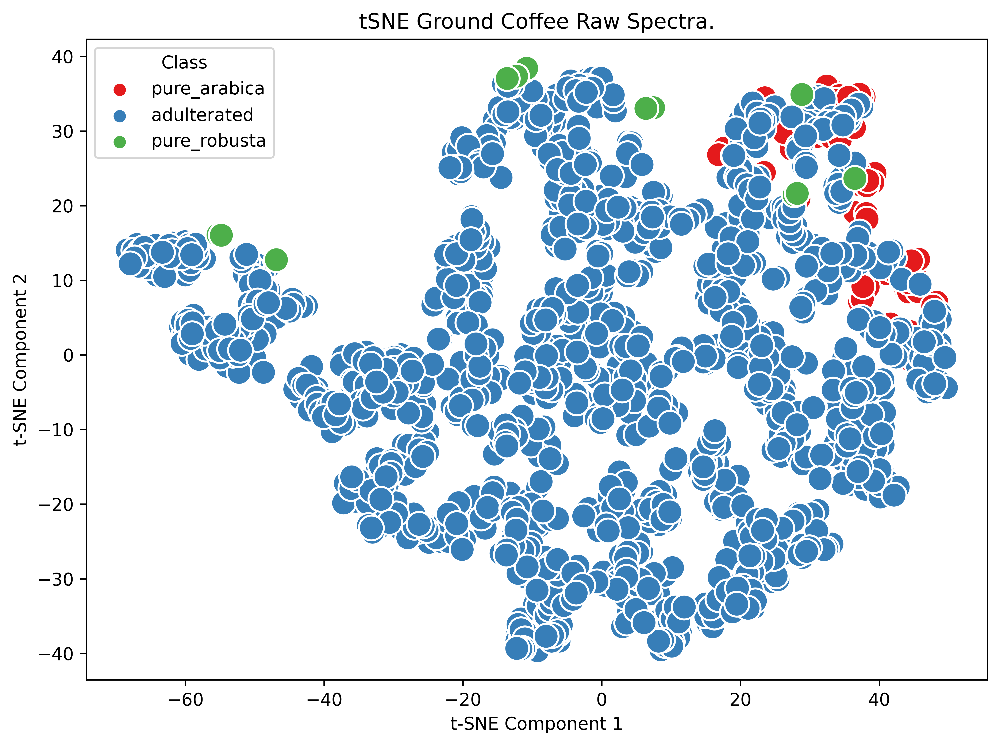

In [9]:
# Plotting 
plt.figure(figsize=(8, 6), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'Class',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Ground Coffee Raw Spectra.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Class")
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Ground_Raw.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

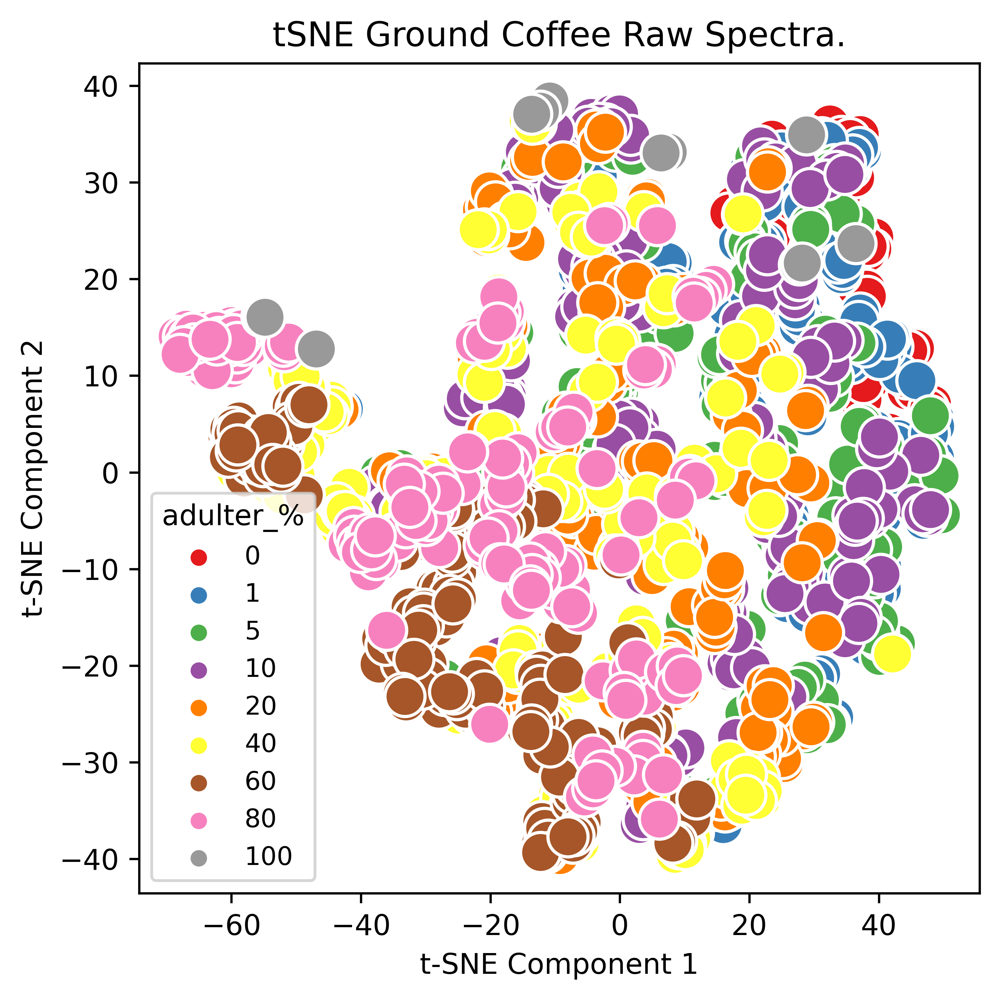

In [10]:
# Plotting-Adulteration percentage
plt.figure(figsize=(5, 5), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'adulter_percent',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Ground Coffee Raw Spectra.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='adulter_%', prop={'size': 9}, loc='best', markerscale=0.8)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Ground_Raw_adult_percent.png", dpi=600, bbox_inches="tight", format="png")
plt.show()


In [11]:
# MSC+SG+first derivative Ground Coffee

# Apply t-SNE to reduce dimensions to 2D
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42,init='pca')
X_tsne = tsne.fit_transform(X_msc_sg_1d)

# Convert to DataFrame for plotting
tsne_df = pd.DataFrame(X_tsne, columns=['TSNE1', 'TSNE2'])
tsne_df[['Class', 'adulter_percent']] = ground_msc_sg_1d[['three_class','adult_percent']] 

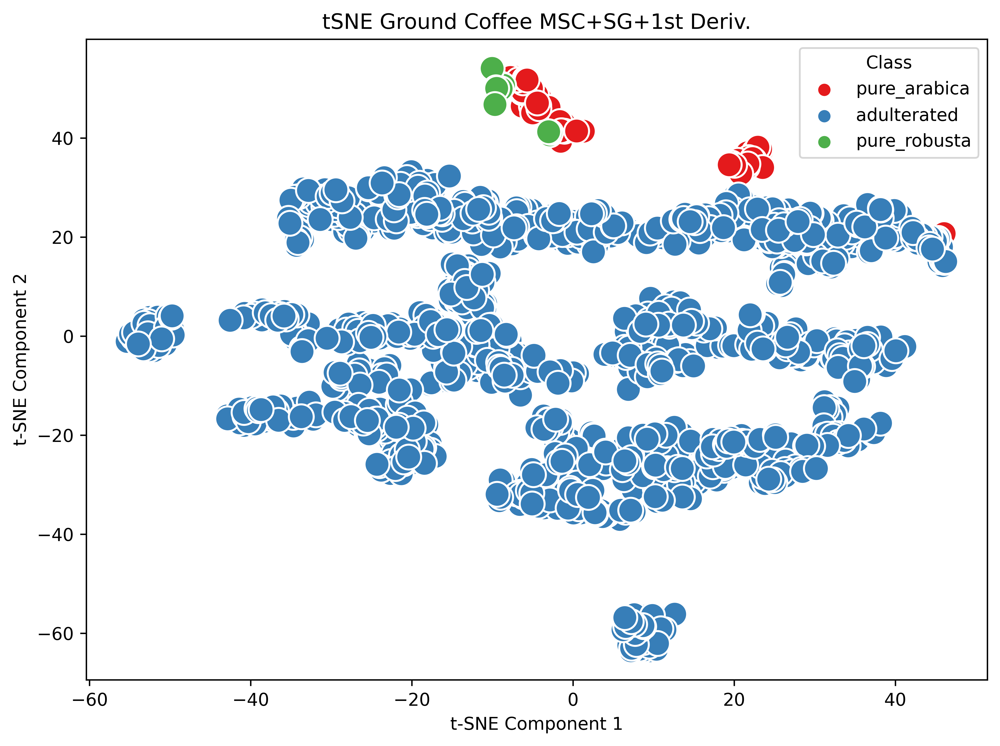

In [12]:
# Plotting 
plt.figure(figsize=(8, 6), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'Class',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Ground Coffee MSC+SG+1st Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Class")
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Ground_MSC_1D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

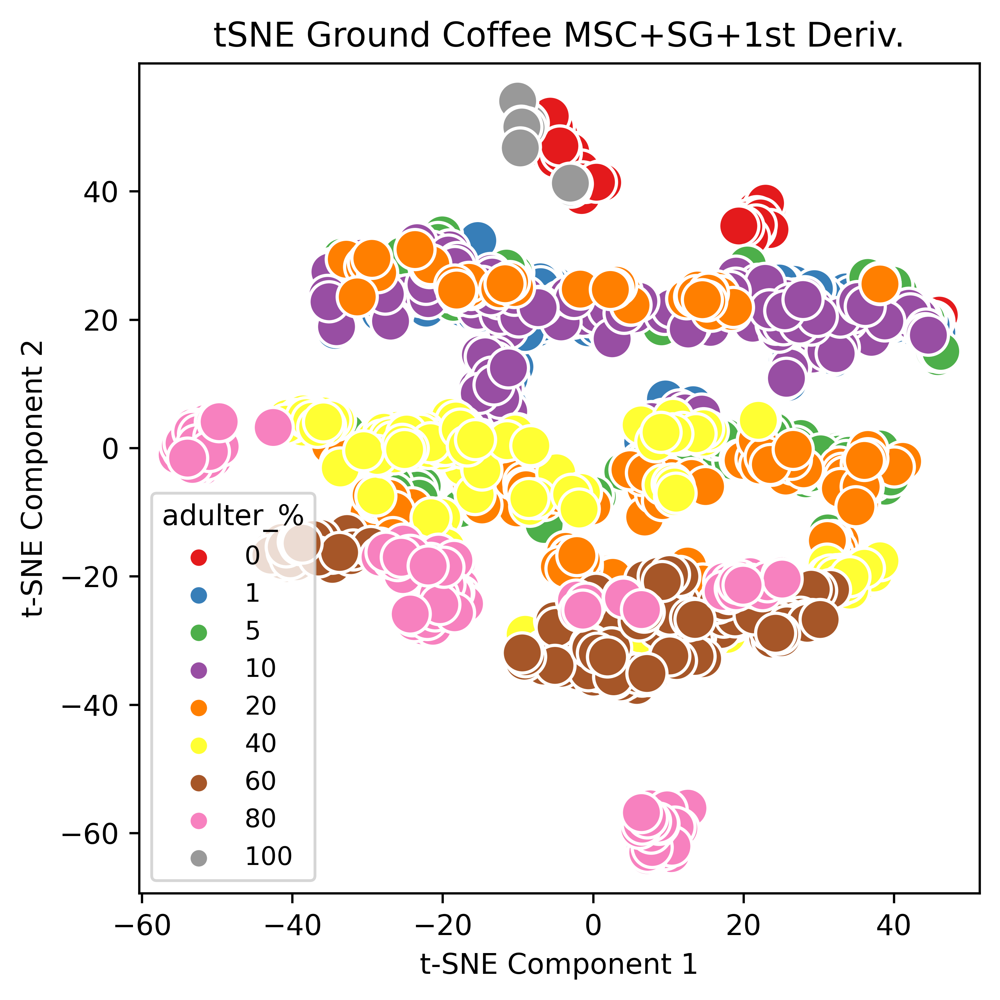

In [13]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'adulter_percent',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Ground Coffee MSC+SG+1st Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='adulter_%', prop={'size': 9}, loc='best', markerscale=0.8)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Ground_MSC_1D_adult_percent.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

In [14]:
# MSC+SG+second derivative Ground Coffee

# Apply t-SNE to reduce dimensions to 2D
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42,init='pca')
X_tsne = tsne.fit_transform(X_msc_sg_2d)

# Convert to DataFrame for plotting
tsne_df = pd.DataFrame(X_tsne, columns=['TSNE1', 'TSNE2'])
tsne_df[['Class', 'adulter_percent']] = ground_msc_sg_2d[['three_class','adult_percent']] 

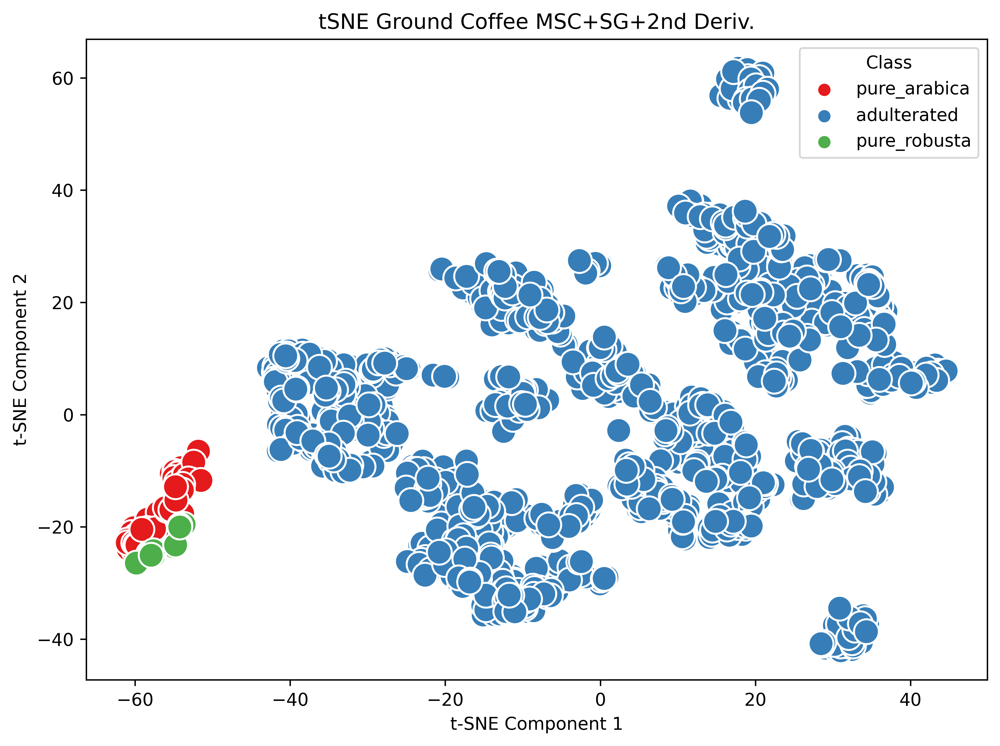

In [15]:
# Plotting 
plt.figure(figsize=(8, 6), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'Class',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Ground Coffee MSC+SG+2nd Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Class")
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Ground_MSC_2D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

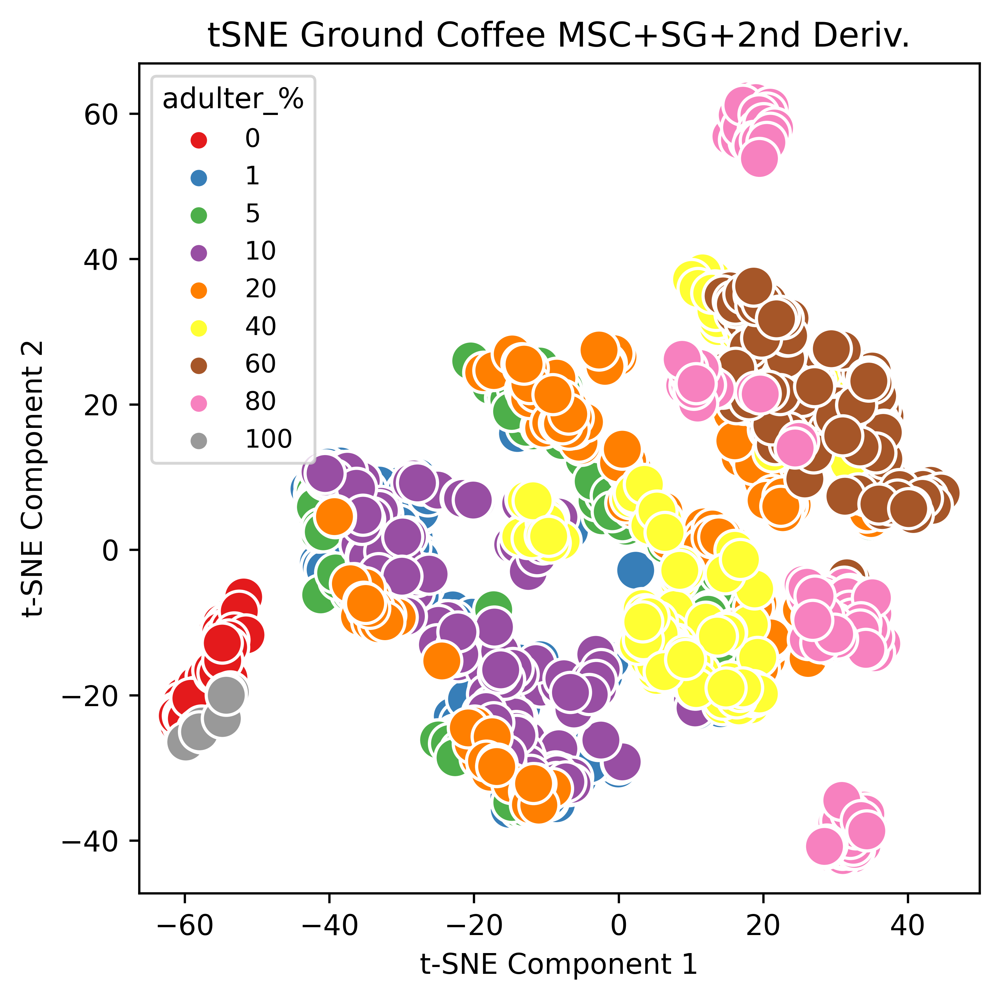

In [16]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'adulter_percent',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Ground Coffee MSC+SG+2nd Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='adulter_%', prop={'size': 9}, loc='best', markerscale=0.8)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Ground_MSC_2D_adult_percent.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

In [17]:
# SNV+SG+first derivative Ground Coffee

# Apply t-SNE to reduce dimensions to 2D
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42,init='pca')
X_tsne = tsne.fit_transform(X_snv_sg_1d)

# Convert to DataFrame for plotting
tsne_df = pd.DataFrame(X_tsne, columns=['TSNE1', 'TSNE2'])
tsne_df[['Class', 'adulter_percent']] = ground_snv_sg_1d[['three_class','adult_percent']] 

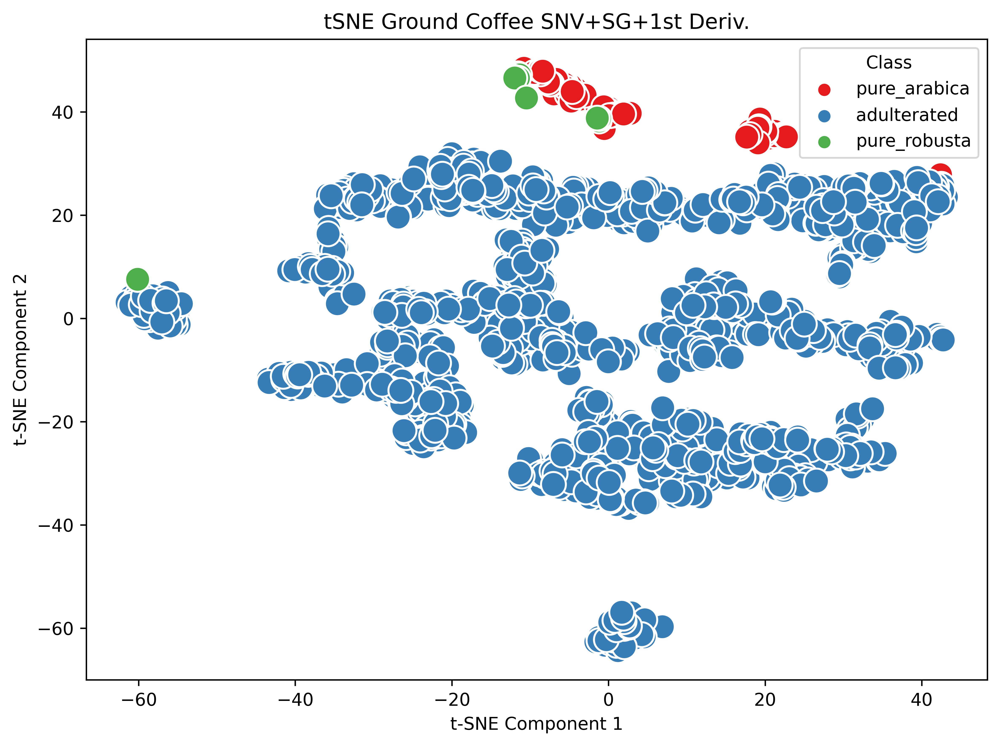

In [18]:
# Plotting 
plt.figure(figsize=(8, 6), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'Class',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Ground Coffee SNV+SG+1st Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Class")
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Ground_SNV_1D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

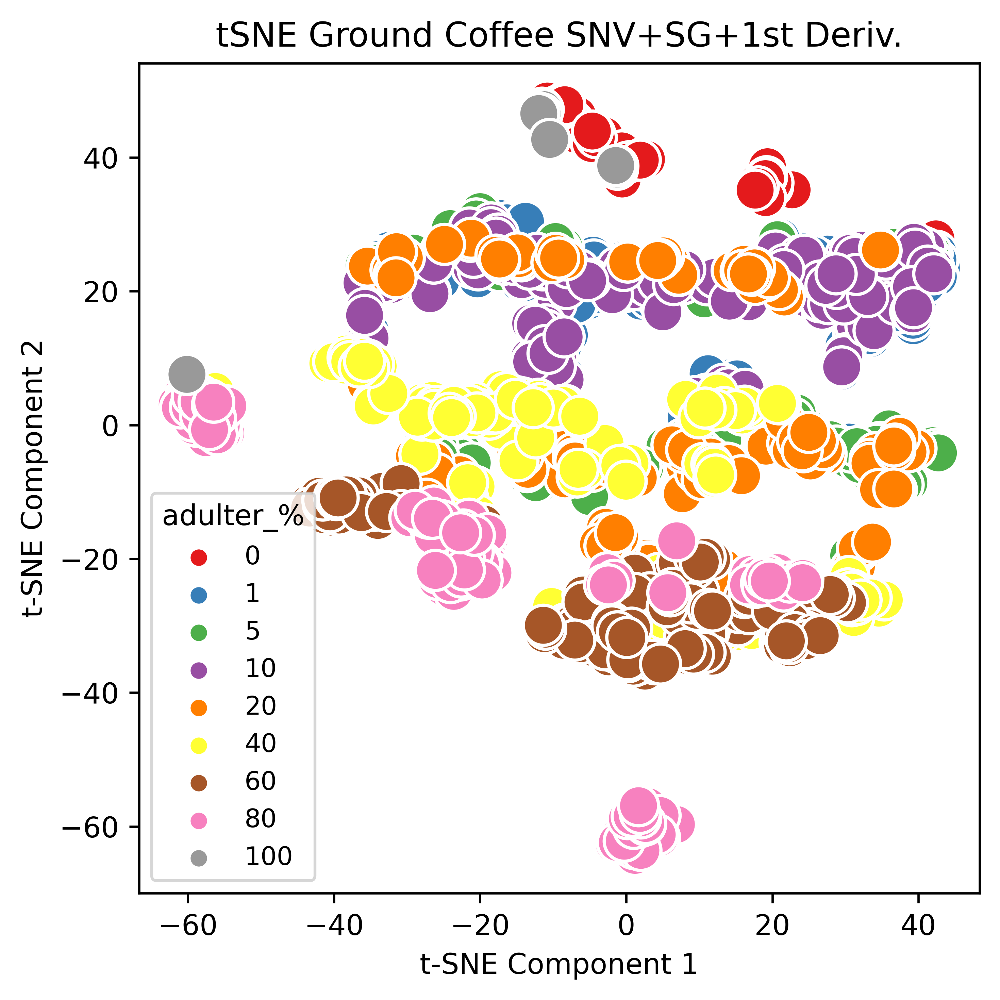

In [19]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'adulter_percent',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Ground Coffee SNV+SG+1st Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='adulter_%', prop={'size': 9}, loc='best', markerscale=0.8)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Ground_SNV_1D_adult_percent.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

In [20]:
# SNV+SG+second derivative Ground Coffee

# Apply t-SNE to reduce dimensions to 2D
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42,init='pca')
X_tsne = tsne.fit_transform(X_snv_sg_2d)

# Convert to DataFrame for plotting
tsne_df = pd.DataFrame(X_tsne, columns=['TSNE1', 'TSNE2'])
tsne_df[['Class', 'adulter_percent']] = ground_snv_sg_2d[['three_class','adult_percent']] 

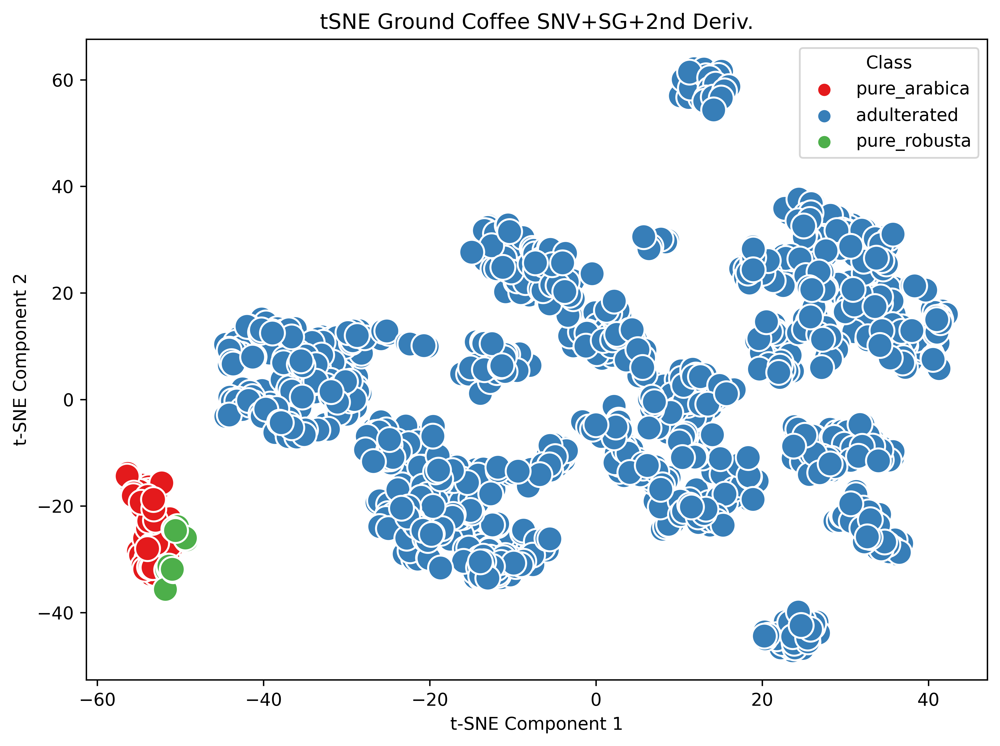

In [21]:
# Plotting 
plt.figure(figsize=(8, 6), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'Class',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Ground Coffee SNV+SG+2nd Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Class")
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Ground_SNV_2D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

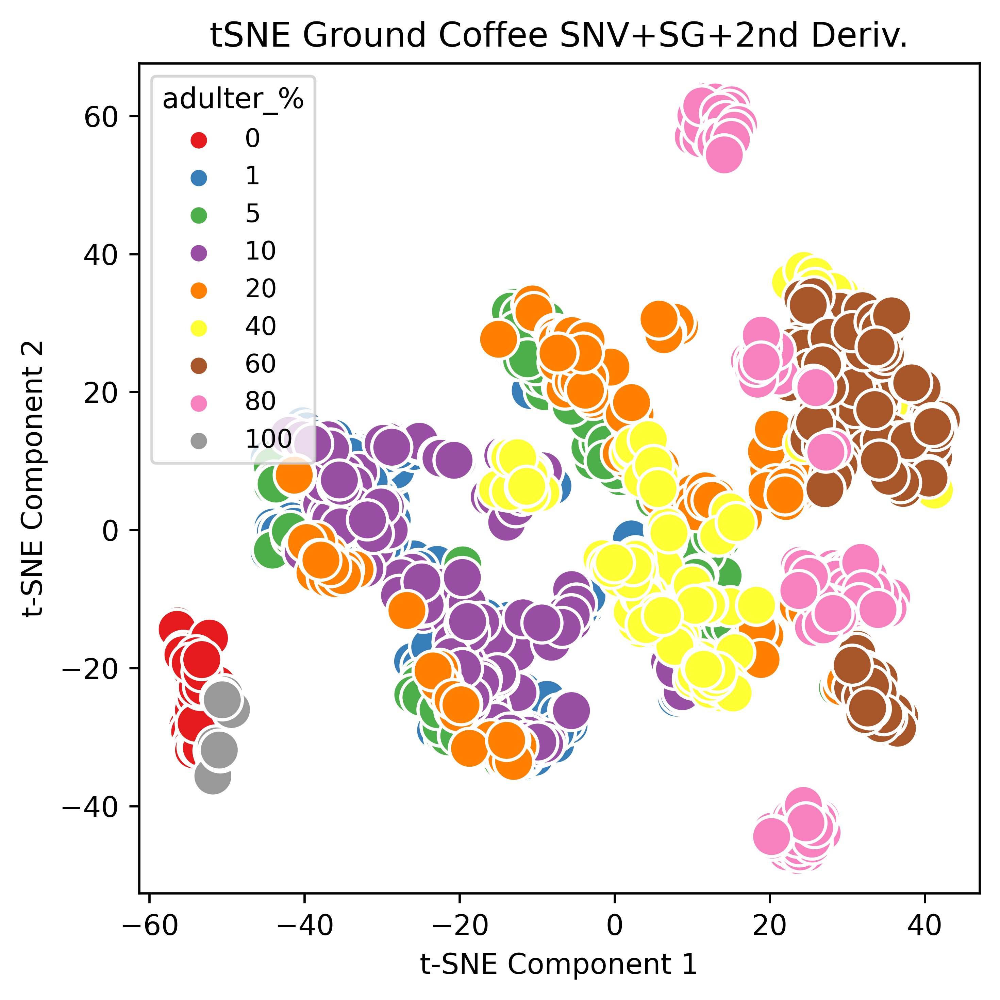

In [22]:
# Plotting 
plt.figure(figsize=(5, 5), dpi=600)

# Scatterplot
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', 
                 hue = 'adulter_percent',
                palette='Set1', alpha=1.0, s=200)
plt.title("tSNE Ground Coffee SNV+SG+2nd Deriv.")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='adulter_%', prop={'size': 9}, loc='best', markerscale=0.8)
plt.grid(False)
plt.tight_layout()
# Save the figure with high resolution
plt.savefig("tSNE_Ground_SNV_2D_adult_percent.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

### Principal Component Analyis

In [24]:
# Subset columns for aesthetics
columns = ground_raw[['binary_class','three_class','adult_percent']]

In [25]:
# Raw Spectra data 

# Run PCA
pca = PCA(n_components=0.99)
pca_raw = pca.fit_transform(X_raw_scaled)

# Create a dataframe
pca_raw_df = pd.DataFrame(pca_raw, columns = ['PC1','PC2','PC3'])
pca_raw_df[['binary_class','three_class','adult_percent']] = columns

pca_raw_df.head(5)

,PC1,PC2,PC3,binary_class,three_class,adult_percent
0,9.551566,13.267316,0.652544,pure_arabica,pure_arabica,0
1,8.780026,20.034516,0.692442,pure_arabica,pure_arabica,0
2,16.737292,18.740437,2.952575,pure_arabica,pure_arabica,0
3,4.069887,11.888739,1.147600,pure_arabica,pure_arabica,0
4,11.655970,16.628360,1.907195,pure_arabica,pure_arabica,0


In [26]:
# Explained variance of each principal component
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.3f}")
print(f"Explained variance by PC2: {explained_variance[1]:.3f}")
print(f"Explained variance by PC3: {explained_variance[2]:.3f}")

Explained variance by PC1: 0.656
Explained variance by PC2: 0.317
Explained variance by PC3: 0.018


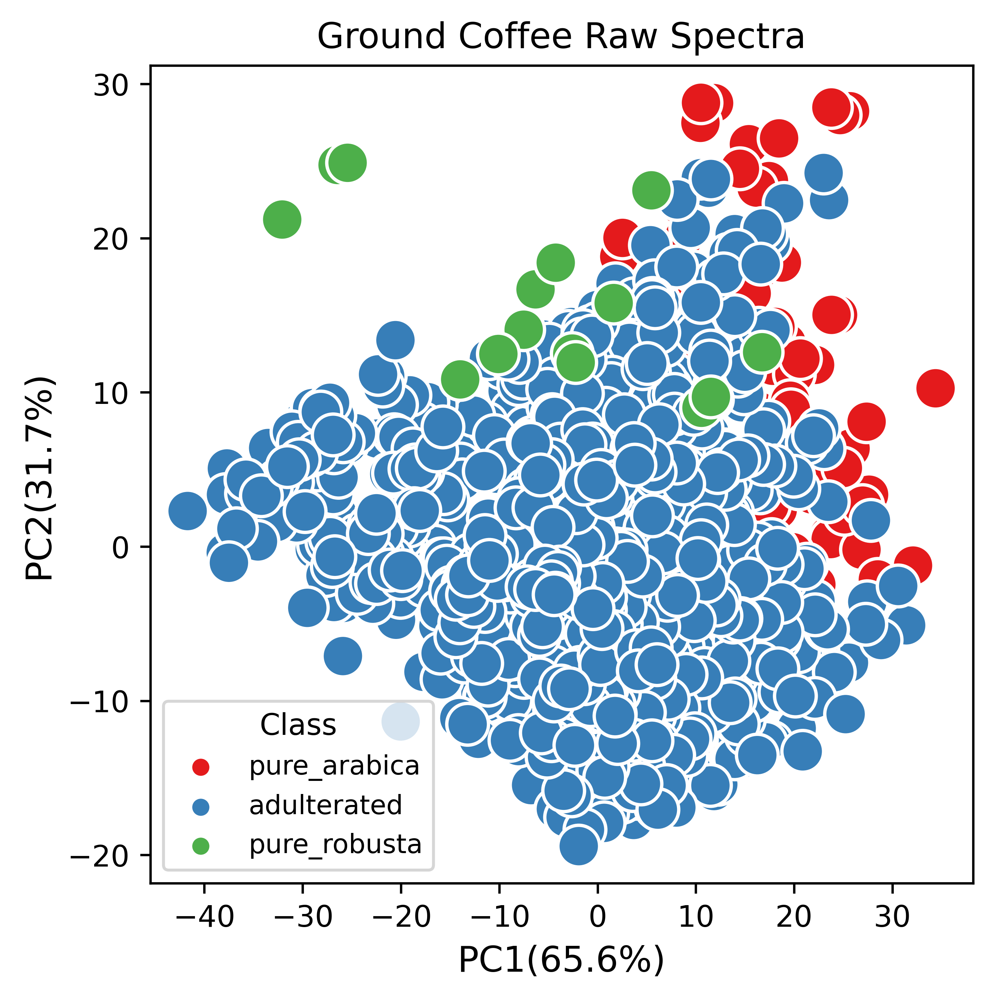

In [27]:
# Create figure
plt.figure(figsize=(5, 5), dpi=600)
sns.scatterplot(data=pca_raw_df, x='PC1', y='PC2', hue='three_class',
                palette='Set1', alpha=1.0, s=200)
plt.title('Ground Coffee Raw Spectra', fontsize=12)  
plt.xlabel('PC1(65.6%)', fontsize=12)
plt.ylabel('PC2(31.7%)', fontsize=12)
plt.legend(title='Class', prop={'size': 9}, loc='best', markerscale=0.8)
plt.savefig("PCA_Ground_Raw.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

In [28]:
# MSC+SG+1st derivative Spectra  

# Run PCA
pca = PCA(n_components=0.99)
pca_msc_1d = pca.fit_transform(X_msc_sg_1d)


# Create a dataframe
pca_msc_1d_df = pd.DataFrame(pca_msc_1d, columns = ['PC1','PC2','PC3','PC4','PC5'])
pca_msc_1d_df[['binary_class','three_class','adult_percent']] = columns

pca_msc_1d_df.head(5)

,PC1,PC2,PC3,PC4,PC5,binary_class,three_class,adult_percent
0,-0.003665,0.006511,-0.003055,0.000389,-0.000330,pure_arabica,pure_arabica,0
1,-0.008059,0.007122,-0.004170,-0.000915,-0.000085,pure_arabica,pure_arabica,0
2,-0.004842,0.006300,-0.004060,0.000876,-0.000339,pure_arabica,pure_arabica,0
3,-0.005779,0.005513,-0.004391,0.000391,-0.001535,pure_arabica,pure_arabica,0
4,-0.005808,0.005693,-0.003282,0.000493,-0.001109,pure_arabica,pure_arabica,0


In [29]:
# Explained variance of each principal component
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.3f}")
print(f"Explained variance by PC2: {explained_variance[1]:.3f}")
print(f"Explained variance by PC3: {explained_variance[2]:.3f}")
print(f"Explained variance by PC4: {explained_variance[3]:.3f}")
print(f"Explained variance by PC5: {explained_variance[4]:.3f}")

Explained variance by PC1: 0.663
Explained variance by PC2: 0.253
Explained variance by PC3: 0.040
Explained variance by PC4: 0.020
Explained variance by PC5: 0.015


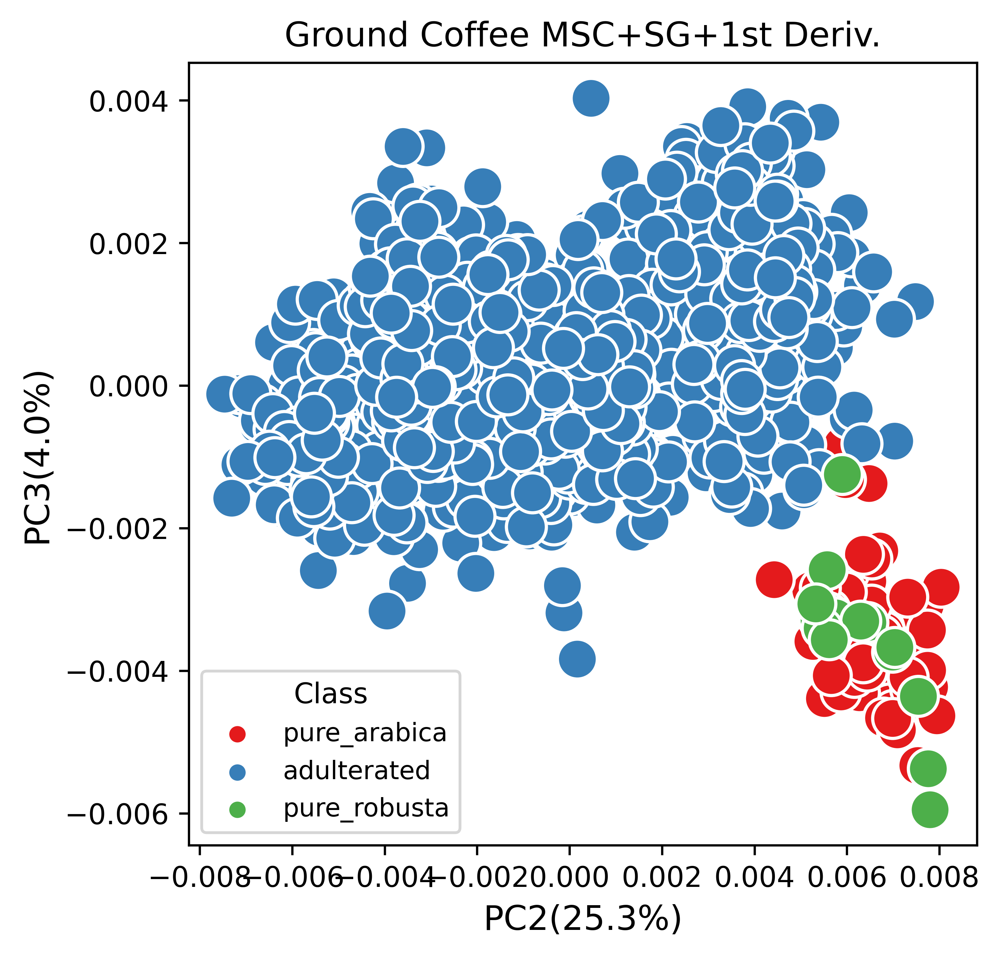

In [30]:
# Create scatter plot
plt.figure(figsize=(5, 5), dpi=600)
sns.scatterplot(data=pca_msc_1d_df, x='PC2', y='PC3', hue='three_class',
                palette='Set1', alpha=1.0, s=200)
plt.title('Ground Coffee MSC+SG+1st Deriv.', fontsize=12)  
plt.xlabel('PC2(25.3%)', fontsize=12)
plt.ylabel('PC3(4.0%)', fontsize=12)
plt.legend(title='Class', prop={'size': 9}, loc='best', markerscale=0.8)
plt.savefig("PCA_Ground_MSC_SG_1D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

In [31]:
# MSC+SG+2nd derivative Spectra  

# Run PCA
pca = PCA(n_components=0.99)
pca_msc_2d = pca.fit_transform(X_msc_sg_2d)


# Create a dataframe
pca_msc_2d_df = pd.DataFrame(pca_msc_2d, columns = ['PC1','PC2','PC3','PC4','PC5','PC6'])
pca_msc_2d_df[['binary_class','three_class','adult_percent']] = columns

pca_msc_2d_df.head(5)

,PC1,PC2,PC3,PC4,PC5,PC6,binary_class,three_class,adult_percent
0,-0.000962,-0.001164,-0.000725,-0.000091,-0.000018,0.000018,pure_arabica,pure_arabica,0
1,-0.000636,-0.001645,-0.000942,0.000026,-0.000021,-0.000046,pure_arabica,pure_arabica,0
2,-0.000836,-0.001303,-0.001000,-0.000162,-0.000027,0.000090,pure_arabica,pure_arabica,0
3,-0.000656,-0.001499,-0.001060,-0.000058,0.000134,0.000071,pure_arabica,pure_arabica,0
4,-0.000669,-0.001425,-0.000754,-0.000101,0.000081,0.000053,pure_arabica,pure_arabica,0


In [32]:
# Explained variance of each principal component
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.3f}")
print(f"Explained variance by PC2: {explained_variance[1]:.3f}")
print(f"Explained variance by PC3: {explained_variance[2]:.3f}")
print(f"Explained variance by PC4: {explained_variance[3]:.3f}")
print(f"Explained variance by PC5: {explained_variance[4]:.3f}")
print(f"Explained variance by PC6: {explained_variance[5]:.3f}")

Explained variance by PC1: 0.547
Explained variance by PC2: 0.327
Explained variance by PC3: 0.082
Explained variance by PC4: 0.023
Explained variance by PC5: 0.011
Explained variance by PC6: 0.003


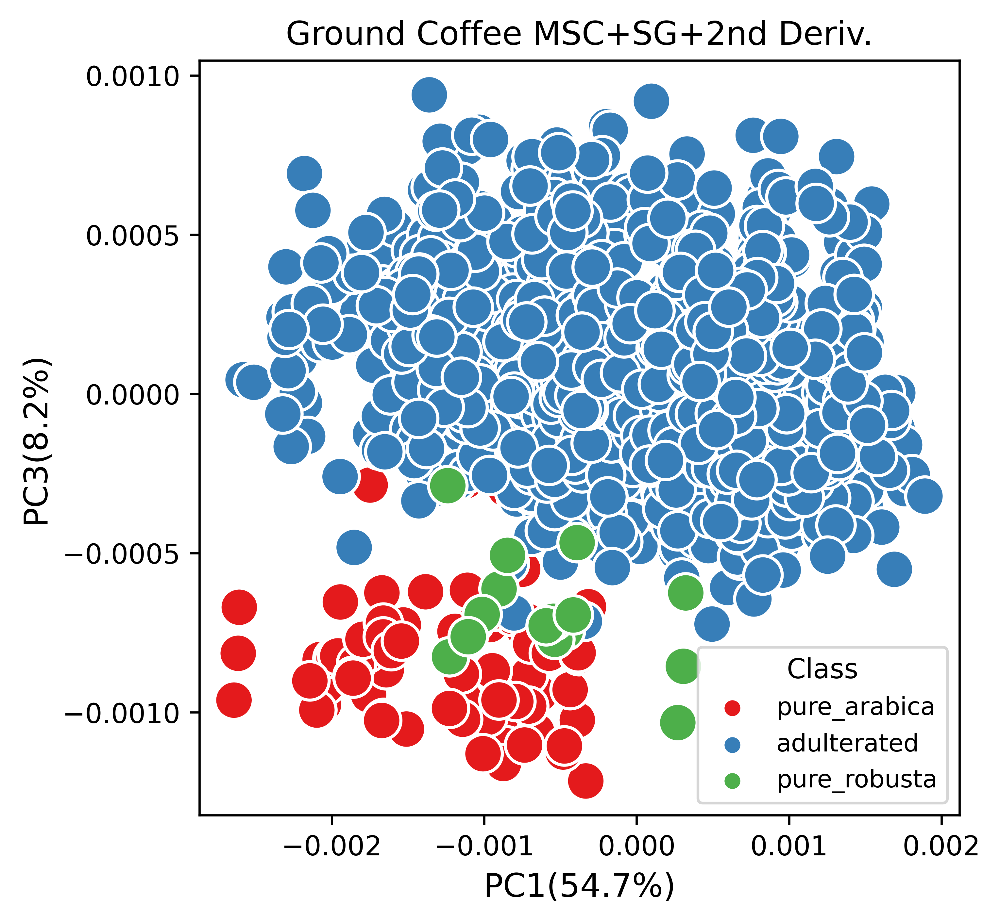

In [33]:
# Create scatter plot
plt.figure(figsize=(5, 5), dpi=600)
sns.scatterplot(data=pca_msc_2d_df, x='PC1', y='PC3', hue='three_class',
                palette='Set1', alpha=1.0, s=200)
plt.title('Ground Coffee MSC+SG+2nd Deriv.', fontsize=12)  
plt.xlabel('PC1(54.7%)', fontsize=12)
plt.ylabel('PC3(8.2%)', fontsize=12)
plt.legend(title='Class', prop={'size': 9}, loc='best', markerscale=0.8) 
plt.savefig("PCA_Ground_MSC_SG_2D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()

In [34]:
# SNV+SG+1st derivative Spectra  

# Run PCA
pca = PCA(n_components=0.99)
pca_snv_1d = pca.fit_transform(X_snv_sg_1d)


# Create a dataframe
pca_snv_1d_df = pd.DataFrame(pca_snv_1d, columns = ['PC1','PC2','PC3','PC4','PC5','PC6'])
pca_snv_1d_df[['binary_class','three_class','adult_percent']] = columns

pca_snv_1d_df.head(5)

,PC1,PC2,PC3,PC4,PC5,PC6,binary_class,three_class,adult_percent
0,-0.044957,0.084259,-0.043836,0.013166,0.004019,-0.003347,pure_arabica,pure_arabica,0
1,-0.110811,0.081966,-0.040079,0.030489,-0.011031,0.001585,pure_arabica,pure_arabica,0
2,-0.062295,0.079499,-0.048865,0.027305,0.009931,-0.000988,pure_arabica,pure_arabica,0
3,-0.073871,0.069315,-0.051821,0.031957,0.003146,-0.015806,pure_arabica,pure_arabica,0
4,-0.075241,0.071144,-0.038900,0.023738,0.005004,-0.011423,pure_arabica,pure_arabica,0


In [35]:
# Explained variance of each principal component
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.3f}")
print(f"Explained variance by PC2: {explained_variance[1]:.3f}")
print(f"Explained variance by PC3: {explained_variance[2]:.3f}")
print(f"Explained variance by PC4: {explained_variance[3]:.3f}")
print(f"Explained variance by PC5: {explained_variance[4]:.3f}")
print(f"Explained variance by PC6: {explained_variance[5]:.3f}")

Explained variance by PC1: 0.635
Explained variance by PC2: 0.249
Explained variance by PC3: 0.047
Explained variance by PC4: 0.028
Explained variance by PC5: 0.020
Explained variance by PC6: 0.015


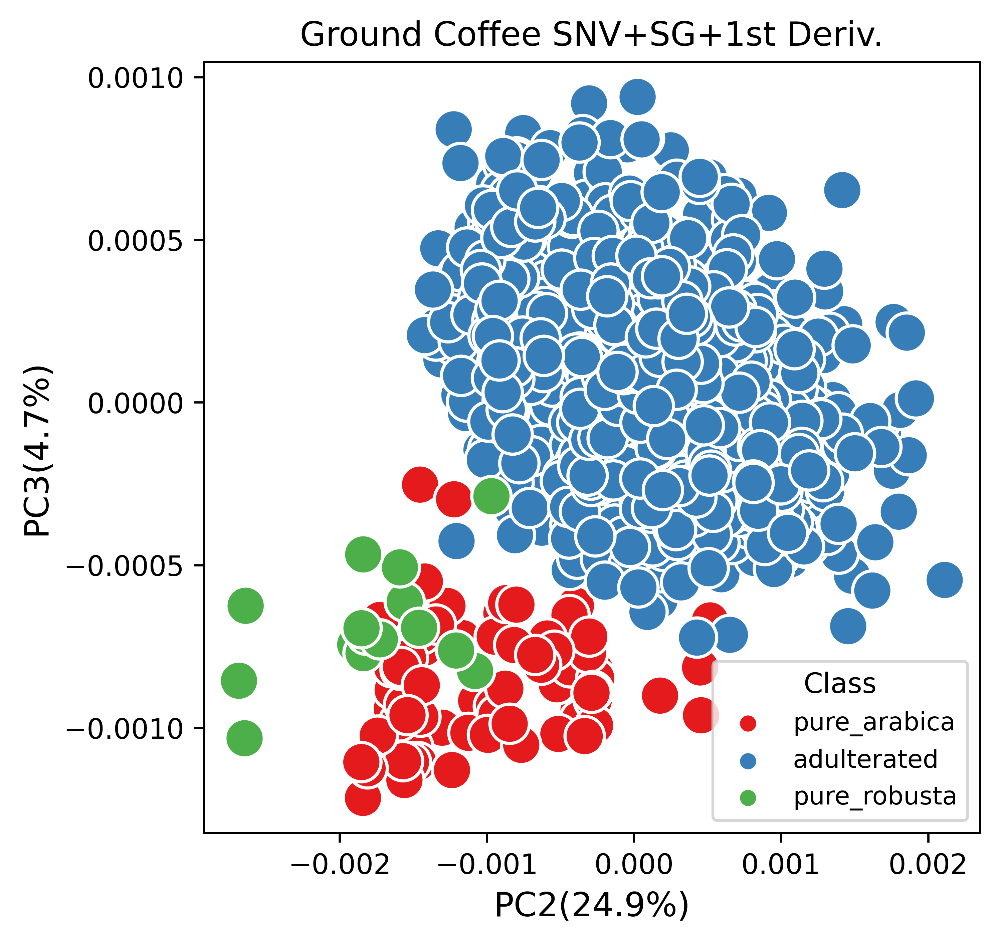

In [36]:
# Create scatter plot
plt.figure(figsize=(5, 5), dpi=600)
sns.scatterplot(data=pca_msc_2d_df, x='PC2', y='PC3', hue='three_class',
                palette='Set1', alpha=1.0, s=200)
plt.title('Ground Coffee SNV+SG+1st Deriv.', fontsize=12)  
plt.xlabel('PC2(24.9%)', fontsize=12)
plt.ylabel('PC3(4.7%)', fontsize=12)
plt.legend(title='Class', prop={'size': 9}, loc='best', markerscale=0.8)
plt.savefig("PCA_Ground_SNV_SG_1D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()


In [37]:
# SNV+SG+1st derivative Spectra  

# Run PCA
pca = PCA(n_components=0.99)
pca_snv_2d = pca.fit_transform(X_snv_sg_2d)


# Create a dataframe
pca_snv_2d_df = pd.DataFrame(pca_snv_2d, columns = ['PC1','PC2','PC3','PC4','PC5','PC6'])
pca_snv_2d_df[['binary_class','three_class','adult_percent']] = columns

pca_snv_2d_df.head(5)

,PC1,PC2,PC3,PC4,PC5,PC6,binary_class,three_class,adult_percent
0,-0.013907,-0.013725,-0.009423,-0.001721,0.000372,-0.000517,pure_arabica,pure_arabica,0
1,-0.008653,-0.020852,-0.011875,0.000260,-0.000368,-0.000291,pure_arabica,pure_arabica,0
2,-0.012068,-0.015792,-0.012897,-0.002467,-0.000357,0.000340,pure_arabica,pure_arabica,0
3,-0.009972,-0.018439,-0.013678,-0.001501,0.001917,0.000781,pure_arabica,pure_arabica,0
4,-0.009949,-0.017543,-0.009709,-0.001838,0.001096,0.000513,pure_arabica,pure_arabica,0


In [38]:
# Explained variance of each principal component
explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PC1: {explained_variance[0]:.3f}")
print(f"Explained variance by PC2: {explained_variance[1]:.3f}")
print(f"Explained variance by PC3: {explained_variance[2]:.3f}")
print(f"Explained variance by PC4: {explained_variance[3]:.3f}")
print(f"Explained variance by PC5: {explained_variance[4]:.3f}")
print(f"Explained variance by PC6: {explained_variance[5]:.3f}")

Explained variance by PC1: 0.538
Explained variance by PC2: 0.326
Explained variance by PC3: 0.084
Explained variance by PC4: 0.024
Explained variance by PC5: 0.014
Explained variance by PC6: 0.005


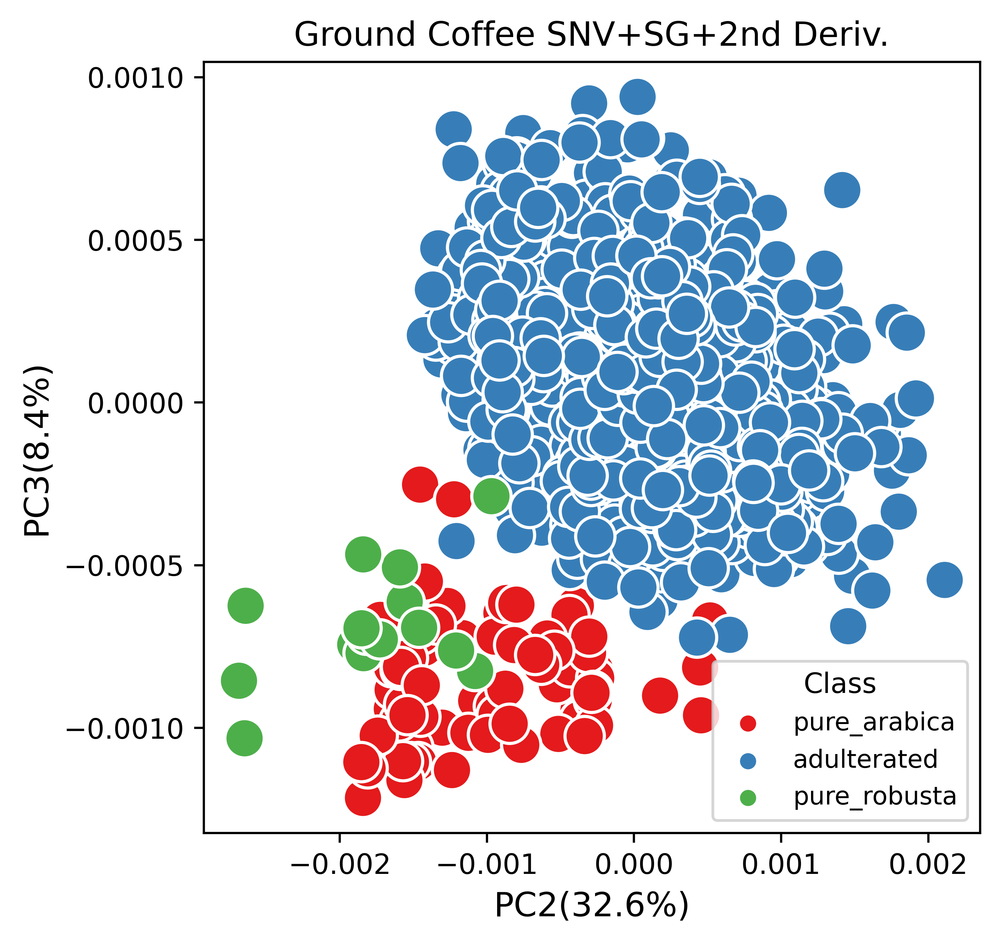

In [39]:
# Create scatter plot
plt.figure(figsize=(5, 5), dpi=600)
sns.scatterplot(data=pca_msc_2d_df, x='PC2', y='PC3', hue='three_class',
                palette='Set1', alpha=1.0, s=200)
plt.title('Ground Coffee SNV+SG+2nd Deriv.', fontsize=12)  
plt.xlabel('PC2(32.6%)', fontsize=12)
plt.ylabel('PC3(8.4%)', fontsize=12)
plt.legend(title='Class', prop={'size': 9}, loc='best', markerscale=0.8)
plt.savefig("PCA_Ground_SNV_SG_2D.png", dpi=600, bbox_inches="tight", format="png")
plt.show()
